In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split, cross_val_score
import random
%matplotlib inline

In [2]:
# считывание данных house_data = тренировочный датасэт X_pr = тестовый

In [3]:
house_data = pd.read_csv('train.csv')
X_pr = pd.read_csv('test.csv')
house_data.shape

(10000, 20)

In [4]:
#просмотр данных
X_pr.head()

,Id,DistrictId,Rooms,Square,LifeSquare,KitchenSquare,Floor,HouseFloor,HouseYear,Ecology_1,Ecology_2,Ecology_3,Social_1,Social_2,Social_3,Healthcare_1,Helthcare_2,Shops_1,Shops_2
0,725,58,2.0,49.882643,33.432782,6.0,6,14.0,1972,0.310199,B,B,11,2748,1,NaN,0,0,B
1,15856,74,2.0,69.263183,NaN,1.0,6,1.0,1977,0.075779,B,B,6,1437,3,NaN,0,2,B
2,5480,190,1.0,13.597819,15.948246,12.0,2,5.0,1909,0.000000,B,B,30,7538,87,4702.0,5,5,B
3,15664,47,2.0,73.046609,51.940842,9.0,22,22.0,2007,0.101872,B,B,23,4583,3,NaN,3,3,B
4,14275,27,1.0,47.527111,43.387569,1.0,17,17.0,2017,0.072158,B,B,2,629,1,NaN,0,0,A


In [175]:
house_data.head()

,Id,DistrictId,Rooms,Square,LifeSquare,KitchenSquare,Floor,HouseFloor,HouseYear,Ecology_1,Ecology_2,Ecology_3,Social_1,Social_2,Social_3,Healthcare_1,Helthcare_2,Shops_1,Shops_2,Price
0,14038,35,2.0,47.981561,29.442751,6.0,7,9.0,1969,0.089040,B,B,33,7976,5,NaN,0,11,B,184966.930730
1,15053,41,3.0,65.683640,40.049543,8.0,7,9.0,1978,0.000070,B,B,46,10309,1,240.0,1,16,B,300009.450063
2,4765,53,2.0,44.947953,29.197612,0.0,8,12.0,1968,0.049637,B,B,34,7759,0,229.0,1,3,B,220925.908524
3,5809,58,2.0,53.352981,52.731512,9.0,8,17.0,1977,0.437885,B,B,23,5735,3,1084.0,0,5,B,175616.227217
4,10783,99,1.0,39.649192,23.776169,7.0,11,12.0,1976,0.012339,B,B,35,5776,1,2078.0,2,4,B,150226.531644


In [176]:
house_data.describe()

,Id,DistrictId,Rooms,Square,LifeSquare,KitchenSquare,Floor,HouseFloor,HouseYear,Ecology_1,Social_1,Social_2,Social_3,Healthcare_1,Helthcare_2,Shops_1,Price
count,10000.00000,10000.000000,10000.000000,10000.000000,7887.000000,10000.000000,10000.000000,10000.000000,1.000000e+04,10000.000000,10000.000000,10000.000000,10000.000000,5202.000000,10000.000000,10000.000000,10000.000000
mean,8383.40770,50.400800,1.890500,56.315775,37.199645,6.273300,8.526700,12.609400,3.990166e+03,0.118858,24.687000,5352.157400,8.039200,1142.904460,1.319500,4.231300,214138.857399
std,4859.01902,43.587592,0.839512,21.058732,86.241209,28.560917,5.241148,6.775974,2.005003e+05,0.119025,17.532614,4006.799803,23.831875,1021.517264,1.493601,4.806341,92872.293865
min,0.00000,0.000000,0.000000,1.136859,0.370619,0.000000,1.000000,0.000000,1.910000e+03,0.000000,0.000000,168.000000,0.000000,0.000000,0.000000,0.000000,59174.778028
25%,4169.50000,20.000000,1.000000,41.774881,22.769832,1.000000,4.000000,9.000000,1.974000e+03,0.017647,6.000000,1564.000000,0.000000,350.000000,0.000000,1.000000,153872.633942
50%,8394.50000,36.000000,2.000000,52.513310,32.781260,6.000000,7.000000,13.000000,1.977000e+03,0.075424,25.000000,5285.000000,2.000000,900.000000,1.000000,3.000000,192269.644879
75%,12592.50000,75.000000,2.000000,65.900625,45.128803,9.000000,12.000000,17.000000,2.001000e+03,0.195781,36.000000,7227.000000,5.000000,1548.000000,2.000000,6.000000,249135.462171
max,16798.00000,209.000000,19.000000,641.065193,7480.592129,2014.000000,42.000000,117.000000,2.005201e+07,0.521867,74.000000,19083.000000,141.000000,4849.000000,6.000000,23.000000,633233.466570


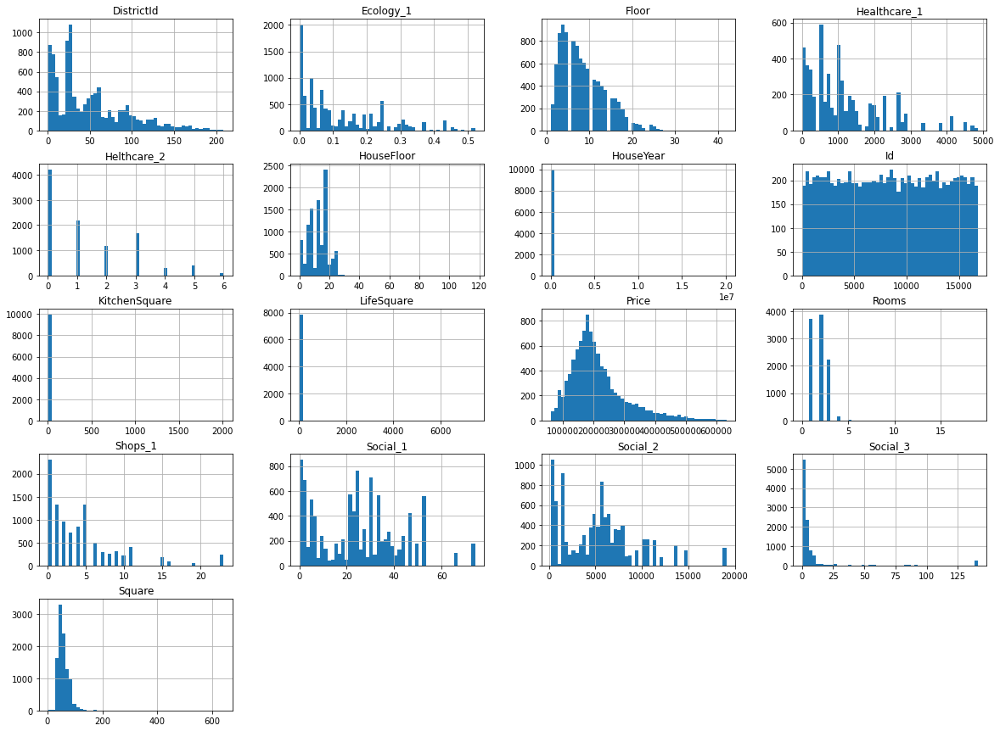

In [177]:
house_data.hist(bins=50,figsize=(20,15))
plt.show()


In [178]:
#замена строковых значений на числовые
house_data = pd.get_dummies(house_data)
X_pr = pd.get_dummies(X_pr)

In [179]:
house_data.head()


,Id,DistrictId,Rooms,Square,LifeSquare,KitchenSquare,Floor,HouseFloor,HouseYear,Ecology_1,...,Healthcare_1,Helthcare_2,Shops_1,Price,Ecology_2_A,Ecology_2_B,Ecology_3_A,Ecology_3_B,Shops_2_A,Shops_2_B
0,14038,35,2.0,47.981561,29.442751,6.0,7,9.0,1969,0.089040,...,NaN,0,11,184966.930730,0,1,0,1,0,1
1,15053,41,3.0,65.683640,40.049543,8.0,7,9.0,1978,0.000070,...,240.0,1,16,300009.450063,0,1,0,1,0,1
2,4765,53,2.0,44.947953,29.197612,0.0,8,12.0,1968,0.049637,...,229.0,1,3,220925.908524,0,1,0,1,0,1
3,5809,58,2.0,53.352981,52.731512,9.0,8,17.0,1977,0.437885,...,1084.0,0,5,175616.227217,0,1,0,1,0,1
4,10783,99,1.0,39.649192,23.776169,7.0,11,12.0,1976,0.012339,...,2078.0,2,4,150226.531644,0,1,0,1,0,1


In [180]:
X_pr.head()

,Id,DistrictId,Rooms,Square,LifeSquare,KitchenSquare,Floor,HouseFloor,HouseYear,Ecology_1,...,Social_3,Healthcare_1,Helthcare_2,Shops_1,Ecology_2_A,Ecology_2_B,Ecology_3_A,Ecology_3_B,Shops_2_A,Shops_2_B
0,725,58,2.0,49.882643,33.432782,6.0,6,14.0,1972,0.310199,...,1,NaN,0,0,0,1,0,1,0,1
1,15856,74,2.0,69.263183,NaN,1.0,6,1.0,1977,0.075779,...,3,NaN,0,2,0,1,0,1,0,1
2,5480,190,1.0,13.597819,15.948246,12.0,2,5.0,1909,0.000000,...,87,4702.0,5,5,0,1,0,1,0,1
3,15664,47,2.0,73.046609,51.940842,9.0,22,22.0,2007,0.101872,...,3,NaN,3,3,0,1,0,1,0,1
4,14275,27,1.0,47.527111,43.387569,1.0,17,17.0,2017,0.072158,...,1,NaN,0,0,0,1,0,1,1,0


In [181]:
house_data = house_data.drop(columns=['Ecology_2_A', 'Ecology_3_A', 'Shops_2_A'], axis=1)
X_pr = X_pr.drop(columns=['Ecology_2_A', 'Ecology_3_A', 'Shops_2_A'], axis=1)

In [182]:
house_data.tail()

,Id,DistrictId,Rooms,Square,LifeSquare,KitchenSquare,Floor,HouseFloor,HouseYear,Ecology_1,Social_1,Social_2,Social_3,Healthcare_1,Helthcare_2,Shops_1,Price,Ecology_2_B,Ecology_3_B,Shops_2_B
9995,77,32,2.0,50.401785,30.476203,5.0,6,5.0,1968,0.135650,46,7960,6,350.0,3,11,196684.316040,1,1,1
9996,6159,18,1.0,41.521546,20.539216,9.0,13,13.0,2000,0.000000,30,5562,0,NaN,0,5,189050.289571,1,1,0
9997,5123,27,1.0,47.939008,NaN,1.0,12,16.0,2015,0.072158,2,629,1,NaN,0,0,159143.805370,1,1,0
9998,5400,75,2.0,43.602562,33.840147,8.0,1,5.0,1961,0.307467,30,5048,9,325.0,2,5,181595.339808,1,0,1
9999,6306,128,1.0,38.666645,21.157874,8.0,7,17.0,1990,0.000000,27,4798,0,30.0,2,8,218714.077615,1,1,1


In [183]:
#заменапропущеных значений
X_pr.head()

,Id,DistrictId,Rooms,Square,LifeSquare,KitchenSquare,Floor,HouseFloor,HouseYear,Ecology_1,Social_1,Social_2,Social_3,Healthcare_1,Helthcare_2,Shops_1,Ecology_2_B,Ecology_3_B,Shops_2_B
0,725,58,2.0,49.882643,33.432782,6.0,6,14.0,1972,0.310199,11,2748,1,NaN,0,0,1,1,1
1,15856,74,2.0,69.263183,NaN,1.0,6,1.0,1977,0.075779,6,1437,3,NaN,0,2,1,1,1
2,5480,190,1.0,13.597819,15.948246,12.0,2,5.0,1909,0.000000,30,7538,87,4702.0,5,5,1,1,1
3,15664,47,2.0,73.046609,51.940842,9.0,22,22.0,2007,0.101872,23,4583,3,NaN,3,3,1,1,1
4,14275,27,1.0,47.527111,43.387569,1.0,17,17.0,2017,0.072158,2,629,1,NaN,0,0,1,1,0


In [184]:
house_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 20 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Id             10000 non-null  int64  
 1   DistrictId     10000 non-null  int64  
 2   Rooms          10000 non-null  float64
 3   Square         10000 non-null  float64
 4   LifeSquare     7887 non-null   float64
 5   KitchenSquare  10000 non-null  float64
 6   Floor          10000 non-null  int64  
 7   HouseFloor     10000 non-null  float64
 8   HouseYear      10000 non-null  int64  
 9   Ecology_1      10000 non-null  float64
 10  Social_1       10000 non-null  int64  
 11  Social_2       10000 non-null  int64  
 12  Social_3       10000 non-null  int64  
 13  Healthcare_1   5202 non-null   float64
 14  Helthcare_2    10000 non-null  int64  
 15  Shops_1        10000 non-null  int64  
 16  Price          10000 non-null  float64
 17  Ecology_2_B    10000 non-null  uint8  
 18  Ecology

In [185]:
house_data.loc[house_data['LifeSquare'].isna(), 'LifeSquare'] = \
    house_data['Square'] - house_data['KitchenSquare']
X_pr.loc[X_pr['LifeSquare'].isna(), 'LifeSquare'] = \
    X_pr['Square'] - X_pr['KitchenSquare']

In [186]:
house_data['Healthcare_1'].median()

900.0

In [187]:
house_data = house_data.fillna(value={'Healthcare_1': house_data['Healthcare_1'].median()})
X_pr = X_pr.fillna(value={'Healthcare_1': house_data['Healthcare_1'].median()})
house_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 20 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Id             10000 non-null  int64  
 1   DistrictId     10000 non-null  int64  
 2   Rooms          10000 non-null  float64
 3   Square         10000 non-null  float64
 4   LifeSquare     10000 non-null  float64
 5   KitchenSquare  10000 non-null  float64
 6   Floor          10000 non-null  int64  
 7   HouseFloor     10000 non-null  float64
 8   HouseYear      10000 non-null  int64  
 9   Ecology_1      10000 non-null  float64
 10  Social_1       10000 non-null  int64  
 11  Social_2       10000 non-null  int64  
 12  Social_3       10000 non-null  int64  
 13  Healthcare_1   10000 non-null  float64
 14  Helthcare_2    10000 non-null  int64  
 15  Shops_1        10000 non-null  int64  
 16  Price          10000 non-null  float64
 17  Ecology_2_B    10000 non-null  uint8  
 18  Ecology

In [188]:
#обработка выбросов и ошибок

In [189]:
X_pr.head()

,Id,DistrictId,Rooms,Square,LifeSquare,KitchenSquare,Floor,HouseFloor,HouseYear,Ecology_1,Social_1,Social_2,Social_3,Healthcare_1,Helthcare_2,Shops_1,Ecology_2_B,Ecology_3_B,Shops_2_B
0,725,58,2.0,49.882643,33.432782,6.0,6,14.0,1972,0.310199,11,2748,1,900.0,0,0,1,1,1
1,15856,74,2.0,69.263183,68.263183,1.0,6,1.0,1977,0.075779,6,1437,3,900.0,0,2,1,1,1
2,5480,190,1.0,13.597819,15.948246,12.0,2,5.0,1909,0.000000,30,7538,87,4702.0,5,5,1,1,1
3,15664,47,2.0,73.046609,51.940842,9.0,22,22.0,2007,0.101872,23,4583,3,900.0,3,3,1,1,1
4,14275,27,1.0,47.527111,43.387569,1.0,17,17.0,2017,0.072158,2,629,1,900.0,0,0,1,1,0


In [190]:
house_data['Rooms'].value_counts()

2.0     3880
1.0     3705
3.0     2235
4.0      150
5.0       18
0.0        8
10.0       2
19.0       1
6.0        1
Name: Rooms, dtype: int64

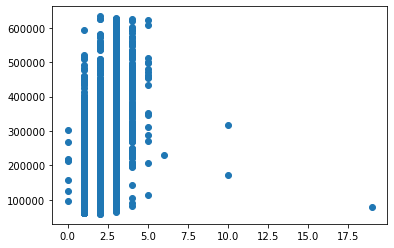

In [191]:
plt.scatter(house_data['Rooms'], house_data['Price'])

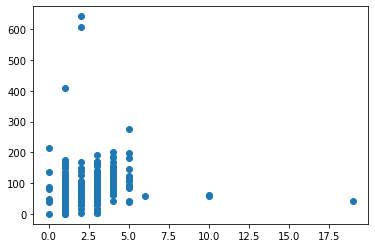

In [192]:
plt.scatter(house_data['Rooms'], house_data['Square'])

In [193]:
house_data['Rooms'].mode()[0]

2.0

In [194]:
house_data.loc[(house_data['Rooms'] > 5), 'Rooms'] = 5
house_data.loc[(house_data['Rooms'] == 0), 'Rooms'] = house_data['Rooms'].mode()[0]
X_pr.loc[(X_pr['Rooms'] > 5), 'Rooms'] = 5
X_pr.loc[(X_pr['Rooms'] == 0), 'Rooms'] = house_data['Rooms'].mode()[0]


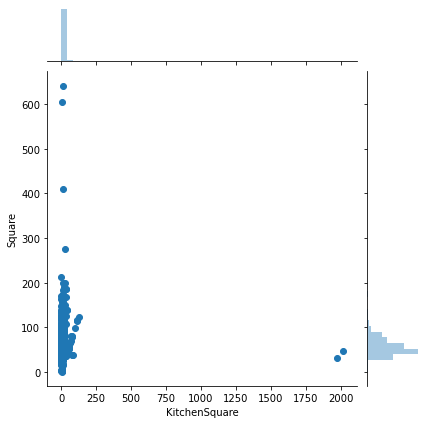

In [195]:
sns.jointplot(house_data['KitchenSquare'], house_data['Square'], kind='scatter', height=6)

In [196]:
house_data.loc[(house_data['KitchenSquare'] > 150) | \
             (house_data['KitchenSquare'] > house_data['Square']), :]

,Id,DistrictId,Rooms,Square,LifeSquare,KitchenSquare,Floor,HouseFloor,HouseYear,Ecology_1,Social_1,Social_2,Social_3,Healthcare_1,Helthcare_2,Shops_1,Price,Ecology_2_B,Ecology_3_B,Shops_2_B
1064,14656,62,1.0,47.100719,46.447960,2014.0,4,1.0,2014,0.072158,2,629,1,900.0,0,0,108337.484207,1,1,0
5149,13703,42,1.0,38.071692,19.723548,73.0,9,10.0,2006,0.158249,21,5731,0,900.0,1,0,160488.033165,1,1,1
7088,6569,27,1.0,38.220258,18.716856,84.0,4,17.0,2018,0.011654,4,915,0,900.0,0,0,99079.960518,1,1,1
8584,14679,81,1.0,32.276663,19.278394,1970.0,6,1.0,1977,0.006076,30,5285,0,645.0,6,6,105539.556275,1,1,1


In [197]:
house_data.loc[(house_data['KitchenSquare'] > 150) | \
             (house_data['KitchenSquare'] > house_data['Square']),
             'KitchenSquare'] = house_data['KitchenSquare'].median()

X_pr.loc[(X_pr['KitchenSquare'] > 150) | \
            (X_pr['KitchenSquare'] > X_pr['Square']),
            'KitchenSquare'] = house_data['KitchenSquare'].median()

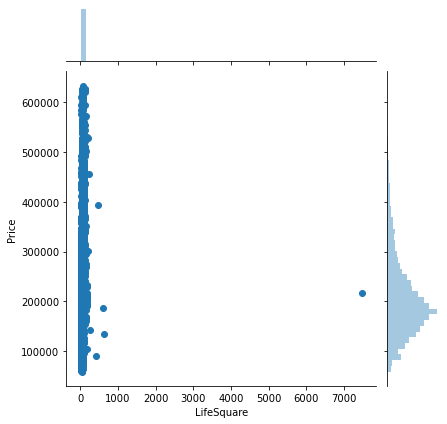

In [198]:
sns.jointplot(house_data['LifeSquare'], house_data['Price'], kind='scatter', height=6)

In [199]:
house_data.loc[(house_data['LifeSquare'] > 400), 'LifeSquare'] = \
        house_data['LifeSquare'].median()
X_pr.loc[(X_pr['LifeSquare'] > 400), 'LifeSquare'] = \
        house_data['LifeSquare'].median()

In [200]:
house_data.loc[(house_data['Square'] > 400) | (house_data['Square'] < 10), 'Square'] = \
            house_data['Square'].median()

X_pr.loc[(X_pr['Square'] > 400) | (X_pr['Square'] < 10), 'Square'] = \
            house_data['Square'].median()

In [201]:
house_data[['Square', 'LifeSquare', 'KitchenSquare']].describe()

,Square,LifeSquare,KitchenSquare
count,10000.000000,10000.000000,10000.000000
mean,56.224584,40.858538,5.861600
std,19.063483,20.570557,5.070426
min,13.784865,0.370619,0.000000
25%,41.794392,25.494155,1.000000
50%,52.513310,37.039625,6.000000
75%,65.889736,49.771534,9.000000
max,275.645284,263.542020,123.000000


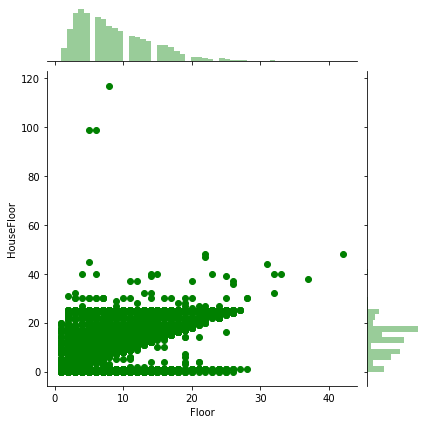

In [202]:
sns.jointplot(house_data['Floor'], house_data['HouseFloor'], kind='scatter', height=6, color='g')

In [203]:
house_data.loc[house_data['HouseFloor'] == 0, 'HouseFloor'] = house_data['HouseFloor'].mode()[0]
X_pr.loc[X_pr['HouseFloor'] == 0, 'HouseFloor'] = house_data['HouseFloor'].mode()[0]

In [204]:
house_data.loc[house_data['HouseFloor'] > 98, 'HouseFloor'] = house_data['HouseFloor'].mode()[0]
X_pr.loc[X_pr['HouseFloor'] > 98, 'HouseFloor'] = house_data['HouseFloor'].mode()[0]

In [205]:
floor_outliers_train = house_data.loc[house_data['Floor'] > house_data['HouseFloor']].index
floor_outliers_test = X_pr.loc[X_pr['Floor'] > X_pr['HouseFloor']].index

floor_outliers_train

Int64Index([  14,   16,   21,   35,   44,   51,   67,   68,   72,   76,
            ...
            9959, 9962, 9971, 9973, 9975, 9984, 9985, 9989, 9991, 9995],
           dtype='int64', length=1578)

In [206]:
house_data.loc[floor_outliers_train, 'Floor'] = \
    house_data.loc[floor_outliers_train, 'HouseFloor'].apply(lambda x: random.randint(1, x))
X_pr.loc[floor_outliers_test, 'Floor'] = \
    X_pr.loc[floor_outliers_test, 'HouseFloor'].apply(lambda x: random.randint(1, x))

In [207]:
house_data.loc[house_data['HouseYear'] > 2020, 'HouseYear'] = 2020

In [208]:
#удаление редких значений 

In [209]:
district_size = house_data['DistrictId'].value_counts().reset_index()\
                .rename(columns={'index':'DistrictId', 'DistrictId':'DistrictSize'})

district_size

,DistrictId,DistrictSize
0,27,851
1,1,652
2,23,565
3,6,511
4,9,294
...,...,...
200,199,1
201,205,1
202,174,1
203,209,1


In [210]:
district_size.loc[district_size['DistrictSize'] < 100, :]

,DistrictId,DistrictSize
20,99,97
21,101,97
22,47,97
23,13,97
24,7,92
...,...,...
200,199,1
201,205,1
202,174,1
203,209,1


In [211]:
districts_popular = district_size.loc[district_size['DistrictSize'] > 100, 'DistrictId'].tolist()

In [212]:
district_size.loc[~district_size['DistrictId'].isin(districts_popular), 'DistrictId'] = 999
district_size = district_size.groupby('DistrictId')['DistrictSize'].agg(
                            DistrictSize='median')
district_size.reset_index(level='DistrictId', inplace=True)
district_size

,DistrictId,DistrictSize
0,1,652
1,6,511
2,8,142
3,9,294
4,11,129
5,21,165
6,23,565
7,27,851
8,30,228
9,34,111


In [213]:
house_data.loc[~house_data['DistrictId'].isin(districts_popular), 'DistrictId'] = 999
X_pr.loc[~X_pr['DistrictId'].isin(districts_popular), 'DistrictId'] = 999

In [214]:
# создание новыйх сильных переменых

In [215]:
X_pr.head()

,Id,DistrictId,Rooms,Square,LifeSquare,KitchenSquare,Floor,HouseFloor,HouseYear,Ecology_1,Social_1,Social_2,Social_3,Healthcare_1,Helthcare_2,Shops_1,Ecology_2_B,Ecology_3_B,Shops_2_B
0,725,58,2.0,49.882643,33.432782,6.0,6,14.0,1972,0.310199,11,2748,1,900.0,0,0,1,1,1
1,15856,74,2.0,69.263183,68.263183,1.0,1,1.0,1977,0.075779,6,1437,3,900.0,0,2,1,1,1
2,5480,999,1.0,13.597819,15.948246,12.0,2,5.0,1909,0.000000,30,7538,87,4702.0,5,5,1,1,1
3,15664,999,2.0,73.046609,51.940842,9.0,22,22.0,2007,0.101872,23,4583,3,900.0,3,3,1,1,1
4,14275,27,1.0,47.527111,43.387569,1.0,17,17.0,2017,0.072158,2,629,1,900.0,0,0,1,1,0


In [216]:
corr_matrix = house_data.corr()
corr_matrix
corr_matrix["Price"].sort_values(ascending=False)

Price            1.000000
Square           0.582257
Rooms            0.569731
DistrictId       0.339848
LifeSquare       0.299046
Social_1         0.263286
KitchenSquare    0.255675
Helthcare_2      0.253090
Social_2         0.239226
Shops_1          0.180876
Healthcare_1     0.128059
Floor            0.103895
HouseFloor       0.086219
Social_3         0.074878
Shops_2_B        0.070388
HouseYear        0.036735
Ecology_2_B      0.022379
Id               0.009880
Ecology_3_B     -0.052585
Ecology_1       -0.058381
Name: Price, dtype: float64

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x124c52340>,
      dtype=object)

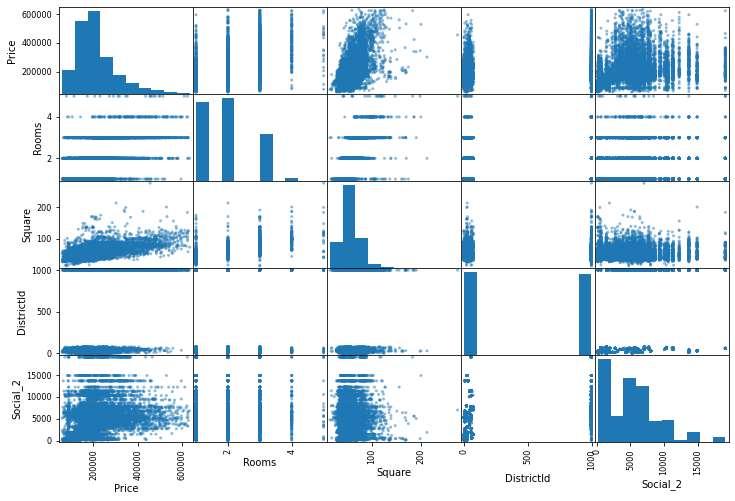

In [217]:
from pandas.plotting import scatter_matrix
attributes=["Price","Rooms","Square","DistrictId", 'Social_2']
scatter_matrix(house_data[attributes],figsize=(12,8))

In [218]:
# пробуем создать сильные новые переменные

In [219]:
house_data["rooms_square"] = house_data["Rooms"] * house_data["Square"]
house_data["rooms_DistrictId"] = house_data["Rooms"] * house_data["DistrictId"]
house_data["square_DistrictId"] = house_data["Square"] * house_data["DistrictId"]
house_data["Square_sqr"] = house_data["Square"] * house_data["Square"]
house_data["helth_social"] = house_data["Helthcare_2"] * house_data["Social_2"]

X_pr["rooms_square"] = X_pr["Rooms"] * X_pr["Square"]
X_pr["rooms_DistrictId"] = X_pr["Rooms"] * X_pr["DistrictId"]
X_pr["square_DistrictId"] = X_pr["Square"] * X_pr["DistrictId"]
X_pr["Square_sqr"] = X_pr["Square"] * X_pr["Square"]
X_pr["helth_social"] = X_pr["Helthcare_2"] * X_pr["Social_2"]

In [220]:
corr_matrix = house_data.corr()
corr_matrix
corr_matrix["Price"].sort_values(ascending=False)

Price                1.000000
rooms_square         0.604896
Square               0.582257
Rooms                0.569731
square_DistrictId    0.549344
rooms_DistrictId     0.525437
Square_sqr           0.519092
DistrictId           0.339848
LifeSquare           0.299046
Social_1             0.263286
KitchenSquare        0.255675
Helthcare_2          0.253090
Social_2             0.239226
Shops_1              0.180876
helth_social         0.178095
Healthcare_1         0.128059
Floor                0.103895
HouseFloor           0.086219
Social_3             0.074878
Shops_2_B            0.070388
HouseYear            0.036735
Ecology_2_B          0.022379
Id                   0.009880
Ecology_3_B         -0.052585
Ecology_1           -0.058381
Name: Price, dtype: float64

In [221]:
house_data["rooms_square_sqr"] = house_data["rooms_square"] * house_data["rooms_square"]
house_data["rooms_per_square_DistrictId"] = house_data["Rooms"] * house_data["Rooms"] * house_data["DistrictId"]

X_pr["rooms_square_sqr"] = X_pr["rooms_square"] * X_pr["rooms_square"]
X_pr["rooms_per_square_DistrictId"] = X_pr["Rooms"] * X_pr["Rooms"] * X_pr["DistrictId"]


In [222]:
corr_matrix = house_data.corr()
corr_matrix
corr_matrix["Price"].sort_values(ascending=False)

Price                          1.000000
rooms_square                   0.604896
Square                         0.582257
Rooms                          0.569731
rooms_per_square_DistrictId    0.562010
square_DistrictId              0.549344
rooms_DistrictId               0.525437
Square_sqr                     0.519092
rooms_square_sqr               0.457545
DistrictId                     0.339848
LifeSquare                     0.299046
Social_1                       0.263286
KitchenSquare                  0.255675
Helthcare_2                    0.253090
Social_2                       0.239226
Shops_1                        0.180876
helth_social                   0.178095
Healthcare_1                   0.128059
Floor                          0.103895
HouseFloor                     0.086219
Social_3                       0.074878
Shops_2_B                      0.070388
HouseYear                      0.036735
Ecology_2_B                    0.022379
Id                             0.009880


In [223]:
house_data.describe()

,Id,DistrictId,Rooms,Square,LifeSquare,KitchenSquare,Floor,HouseFloor,HouseYear,Ecology_1,...,Ecology_2_B,Ecology_3_B,Shops_2_B,rooms_square,rooms_DistrictId,square_DistrictId,Square_sqr,helth_social,rooms_square_sqr,rooms_per_square_DistrictId
count,10000.00000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,...,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,1.000000e+04,10000.000000
mean,8383.40770,506.439600,1.889600,56.224584,40.858538,5.861600,7.421700,13.040300,1984.872400,0.118858,...,0.990300,0.972500,0.917500,118.012613,988.650700,27874.792237,3524.583920,9893.738200,2.153039e+04,2278.778500
std,4859.01902,486.054287,0.813436,19.063483,20.570557,5.070426,5.045158,6.276338,18.416347,0.119025,...,0.098015,0.163543,0.275139,87.201940,1116.594244,30032.471161,2844.394624,14934.629942,4.064108e+04,3356.519394
min,0.00000,1.000000,1.000000,13.784865,0.370619,0.000000,1.000000,1.000000,1910.000000,0.000000,...,0.000000,0.000000,0.000000,16.117154,1.000000,31.113950,190.022497,0.000000,2.597627e+02,1.000000
25%,4169.50000,27.000000,1.000000,41.794392,25.494155,1.000000,3.000000,9.000000,1974.000000,0.017647,...,1.000000,1.000000,1.000000,42.466958,33.000000,1244.347004,1746.771197,0.000000,1.803443e+03,53.000000
50%,8394.50000,74.000000,2.000000,52.513310,37.039625,6.000000,6.000000,14.000000,1977.000000,0.075424,...,1.000000,1.000000,1.000000,102.659942,186.000000,5736.520624,2757.647719,6163.000000,1.053906e+04,558.000000
75%,12592.50000,999.000000,2.000000,65.889736,49.771534,9.000000,11.000000,17.000000,2001.000000,0.195781,...,1.000000,1.000000,1.000000,156.675020,1998.000000,48973.985261,4341.457265,14130.000000,2.454706e+04,3996.000000
max,16798.00000,999.000000,5.000000,275.645284,263.542020,123.000000,42.000000,48.000000,2020.000000,0.521867,...,1.000000,1.000000,1.000000,1378.226420,4995.000000,275369.638792,75980.322633,95415.000000,1.899508e+06,24975.000000


#отбор признаков

In [225]:
house_data.to_csv('train_prepared.csv')
X_pr.to_csv('test_prepared.csv')

In [226]:
feature_names = house_data.columns
feature_names.tolist()

['Id',
 'DistrictId',
 'Rooms',
 'Square',
 'LifeSquare',
 'KitchenSquare',
 'Floor',
 'HouseFloor',
 'HouseYear',
 'Ecology_1',
 'Social_1',
 'Social_2',
 'Social_3',
 'Healthcare_1',
 'Helthcare_2',
 'Shops_1',
 'Price',
 'Ecology_2_B',
 'Ecology_3_B',
 'Shops_2_B',
 'rooms_square',
 'rooms_DistrictId',
 'square_DistrictId',
 'Square_sqr',
 'helth_social',
 'rooms_square_sqr',
 'rooms_per_square_DistrictId']

In [227]:
target_name = ['Price']
feature_names = [
   # 'Id',
   # 'DistrictId',
    'Rooms',
    'Square',
    'LifeSquare',
    'KitchenSquare',
    'Floor',
    'HouseFloor',
    'HouseYear',
    'Ecology_1',
    'Social_1',
    'Social_2',
    'Social_3',
    #'Healthcare_1',
    'Helthcare_2',
    'Shops_1',
    #'Price',
   # 'Ecology_2_B',
#    'Ecology_3_B',
    'Shops_2_B',
    'rooms_square',
    'rooms_DistrictId',
    'square_DistrictId',
    'Square_sqr',
    'helth_social',
    'rooms_square_sqr',
    'rooms_per_square_DistrictId']

In [228]:
test_id = X_pr['Id']
X = house_data[feature_names]
y = house_data[target_name]

X_pr = X_pr[feature_names]

In [229]:
X.shape

(10000, 21)

In [230]:
y.shape

(10000, 1)

In [231]:
y.head()

,Price
0,184966.930730
1,300009.450063
2,220925.908524
3,175616.227217
4,150226.531644


In [232]:
# Строим модель

In [233]:
from sklearn.ensemble import RandomForestRegressor
forest = RandomForestRegressor(max_depth=19, 
                               max_features=6, 
                               n_estimators=100,
                               random_state=42)

In [234]:
from sklearn.model_selection import KFold, GridSearchCV
kf = KFold(n_splits=5, random_state=42, shuffle=True)

cv_score = cross_val_score(forest, X, y, scoring='r2', cv=kf)
print('R2: {:.5f}'.format(cv_score.mean()))


R2: 0.73375


In [235]:
from sklearn.metrics import r2_score

In [236]:
forest.fit(X, y)
importances = forest.feature_importances_
feat_importances = pd.Series(importances, index=feature_names)
feat_importances.sort_values(ascending=True, inplace=True)

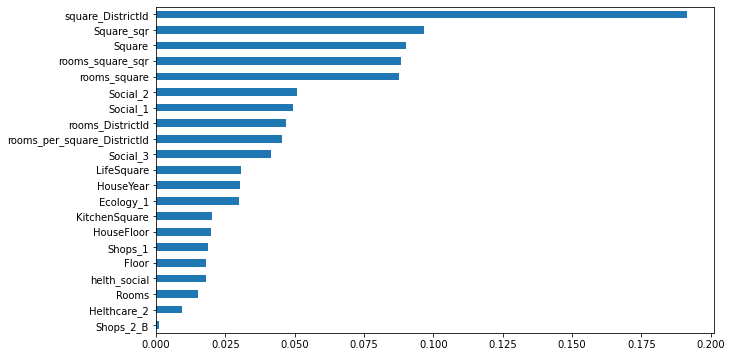

In [237]:
feat_importances.plot(kind='barh', figsize=(10, 6))

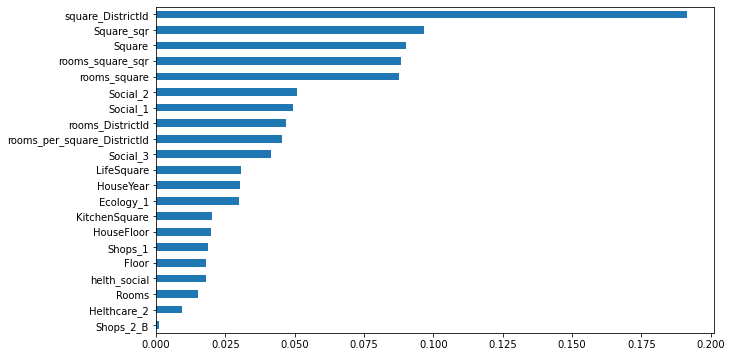

In [238]:
feat_importances.plot(kind='barh', figsize=(10, 6))

In [239]:
params = {
    'n_estimators': [400],
    'max_depth': [18,19,20],
    'max_features': [5,6,7]
}

In [240]:
forest_grid = GridSearchCV(forest, params, scoring='r2', 
                  cv=KFold(n_splits=10, random_state=42, shuffle=True), 
                  n_jobs=-1)
forest_grid.fit(X, y)
print(forest_grid.best_params_)
print('R2 на train: {:.5f}'.format(forest_grid.best_score_))

{'max_depth': 19, 'max_features': 7, 'n_estimators': 400}
R2 на train: 0.74018


In [241]:
#прогноз на тестовых данных

In [242]:
forest_best = forest_grid.best_estimator_

y_pred = forest_best.predict(X_pr)
X_pr.head()

,Rooms,Square,LifeSquare,KitchenSquare,Floor,HouseFloor,HouseYear,Ecology_1,Social_1,Social_2,...,Helthcare_2,Shops_1,Shops_2_B,rooms_square,rooms_DistrictId,square_DistrictId,Square_sqr,helth_social,rooms_square_sqr,rooms_per_square_DistrictId
0,2.0,49.882643,33.432782,6.0,6,14.0,1972,0.310199,11,2748,...,0,0,1,99.765287,116.0,2893.193317,2488.278112,0,9953.112446,232.0
1,2.0,69.263183,68.263183,1.0,1,1.0,1977,0.075779,6,1437,...,0,2,1,138.526367,148.0,5125.475577,4797.388585,0,19189.554340,296.0
2,1.0,13.597819,15.948246,12.0,2,5.0,1909,0.000000,30,7538,...,5,5,1,13.597819,999.0,13584.220683,184.900668,37690,184.900668,999.0
3,2.0,73.046609,51.940842,9.0,22,22.0,2007,0.101872,23,4583,...,3,3,1,146.093218,1998.0,72973.562606,5335.807118,13749,21343.228471,3996.0
4,1.0,47.527111,43.387569,1.0,17,17.0,2017,0.072158,2,629,...,0,0,0,47.527111,27.0,1283.231989,2258.826252,0,2258.826252,27.0


In [245]:
preds = pd.DataFrame()
preds['Id'] = test_id
preds['Price'] = y_pred
preds.head()

,Id,Price
0,725,164095.296231
1,15856,229218.150452
2,5480,139156.830132
3,15664,338070.135775
4,14275,145473.241465


In [246]:
preds.to_csv('KucherM_prediction.csv', index=False)